# Object Localization

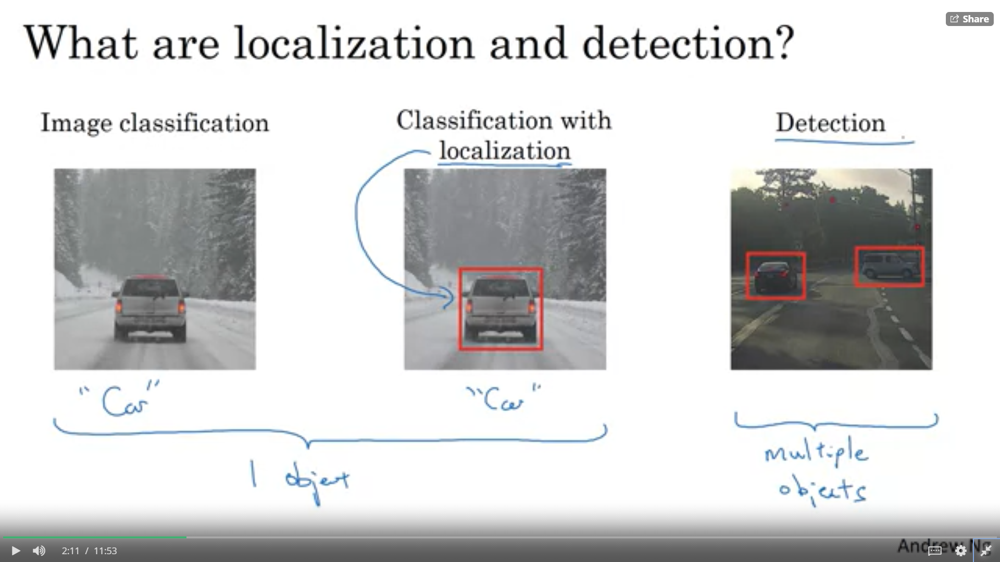

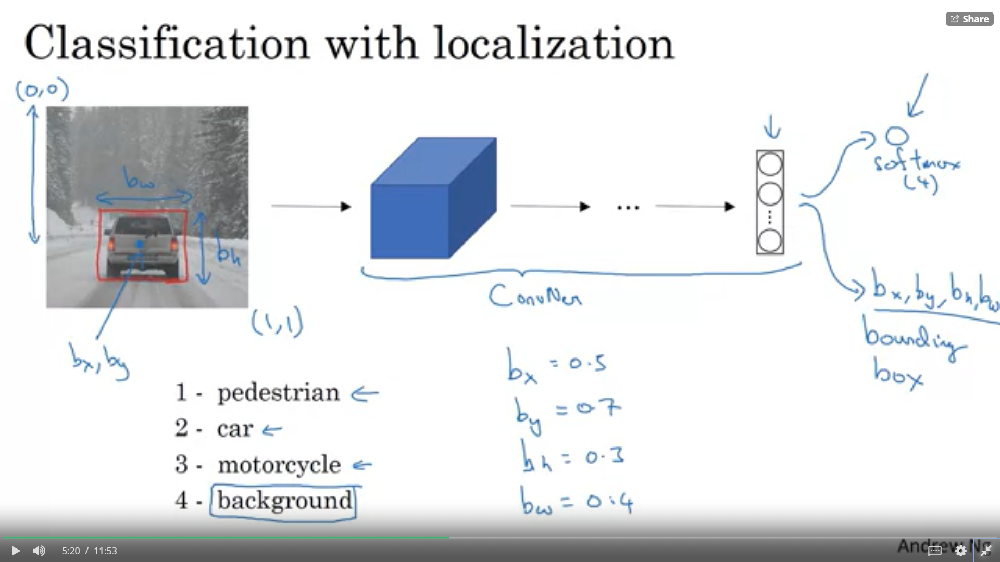

So if there's no pedestrian, no car, no motorcycle, then you might have an output background. So these are your classes, they have a softmax with four possible outputs. So this is the standard classification pipeline. How about if you want to localize the car in the image as well. To do that, you can change your neural network to have a few more output units that output a bounding box. So, in particular, you can have the neural network output four more numbers, and I'm going to call them bx, by, bh, and bw. And these four numbers parameterized the bounding box of the detected object. 

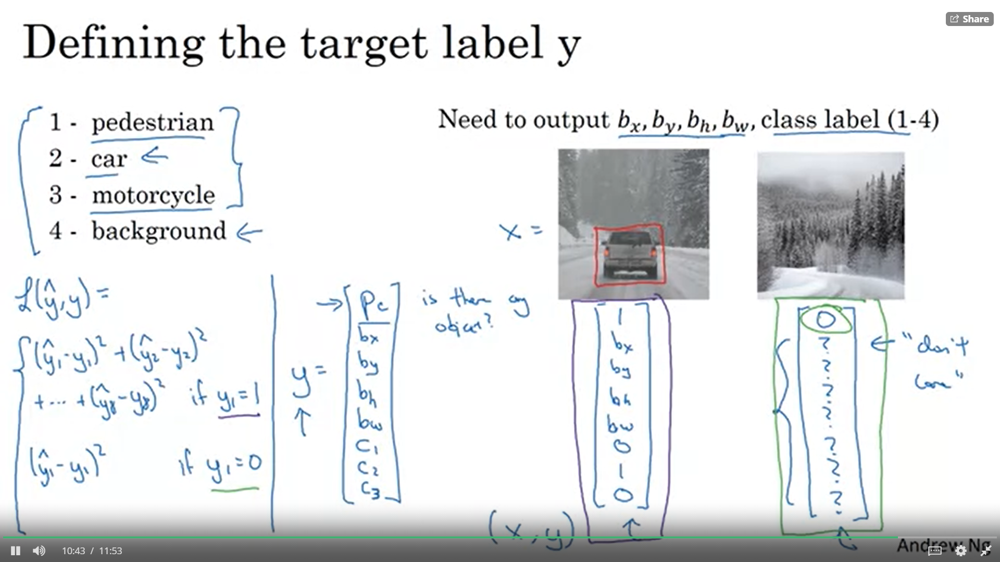

So, if the object is, classes 1, 2 or 3, pc will be equal to 1. And if it's the background class, so if it's none of the objects you're trying to detect, then pc will be 0. And pc you can think of that as standing for the probability that there's an object. 

 And `remember in the problem we're addressing we assume that your image has only one object`.

# Landmark Detection

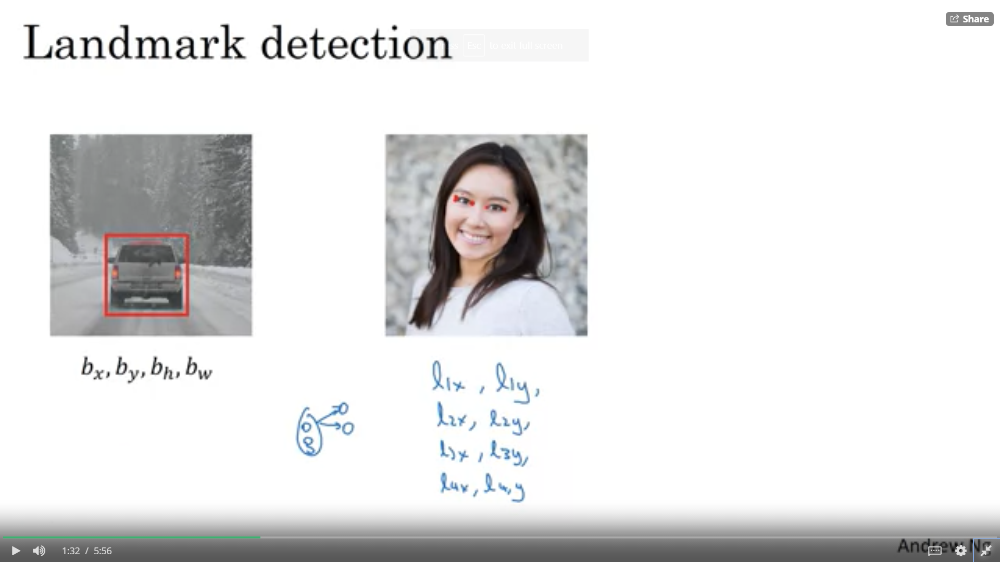

To find the co-ordinates of all the four locations of eyes. So, if we call the points, the first, second, third and fourth points going from left to right, then you could modify the neural network now to output l1x, l1y for the first point and l2x, l2y for the second point and so on, so that the neural network can output the estimated position of all those four points of the person's face. 

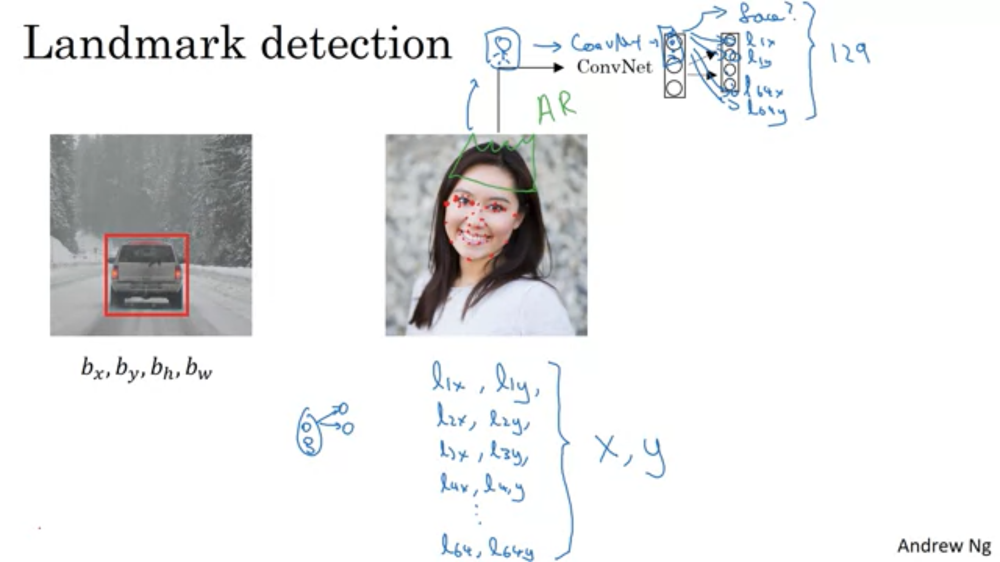

So this example would have 129 output units, one for is your face or not? And then if you have 64 landmarks, that's sixty-four times two, so 128 plus one output units and this can tell you if there's a face as well as where all the key landmarks on the face. 

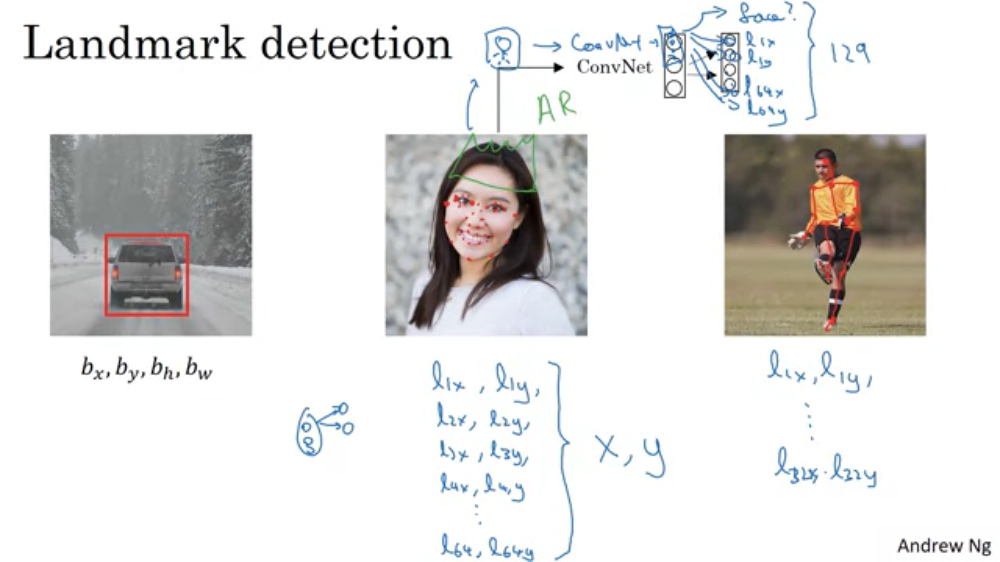

One last example, if you are interested in people pose detection, you could also define a few key positions like the midpoint of the chest, the left shoulder, left elbow, the wrist, and so on, and just have a neural network to annotate key positions in the person's pose as well and by having a neural network output, all of those points I'm annotating, you could also have the neural network output the pose of the person. And of course, to do that you also need to specify on these key landmarks like maybe l1x and l1y is the midpoint of the chest down to maybe l32x, l32y, if you use 32 coordinates to specify the pose of the person.

So, the labels have to be consistent across different images. But if you can hire labelers or label yourself a big enough data set to do this, then a neural network can output all of these landmarks which is going to used to carry out other interesting effect such as with the pose of the person, maybe try to recognize someone's emotion from a picture, and so on. So that's it for landmark detection. 

# Object Detection

Let's say you want to build a car detection algorithm. Here's what you can do. You can first create a label training set, so x and y with closely cropped examples of cars. So, this is image x has a positive example, there's a car, here's a car, here's a car, and then there's not a car, there's not a car. And for our purposes in this training set, you can start off with the one with the car closely cropped images. Meaning that x is pretty much only the car. So, you can take a picture and crop out and just cut out anything else that's not part of a car. So you end up with the car centered in pretty much the entire image. Given this label training set, you can then train a convNET that inputs an image, like one of these closely cropped images. And then the job of the convNET is to output y, zero or one, is there a car or not. Once you've trained up this convNET, you can then use it in Sliding Windows Detection. 

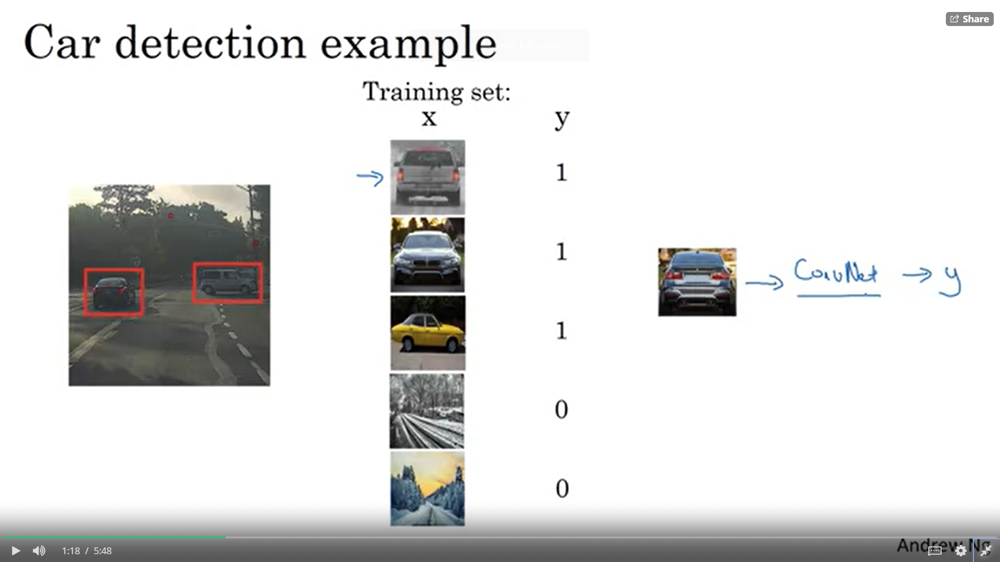

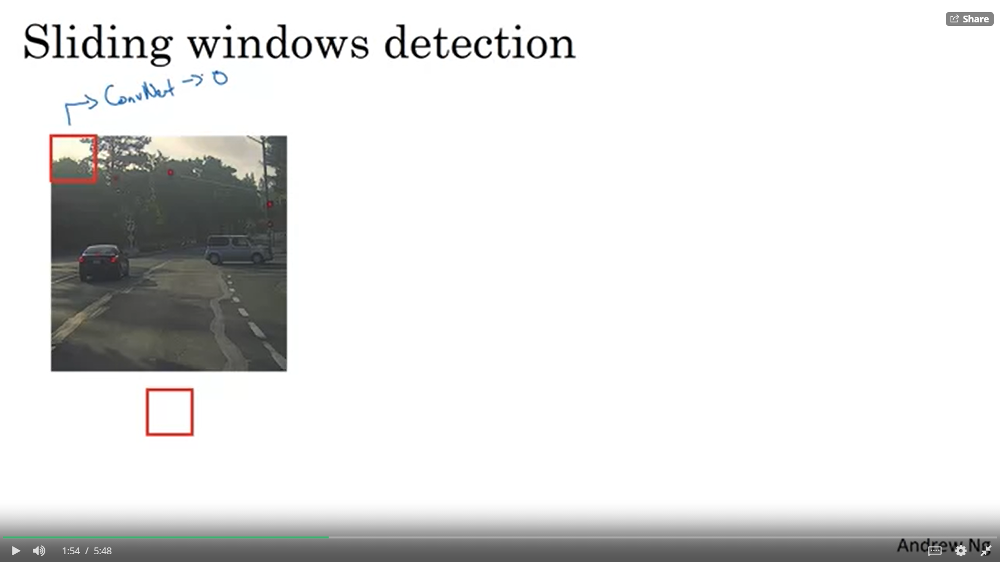

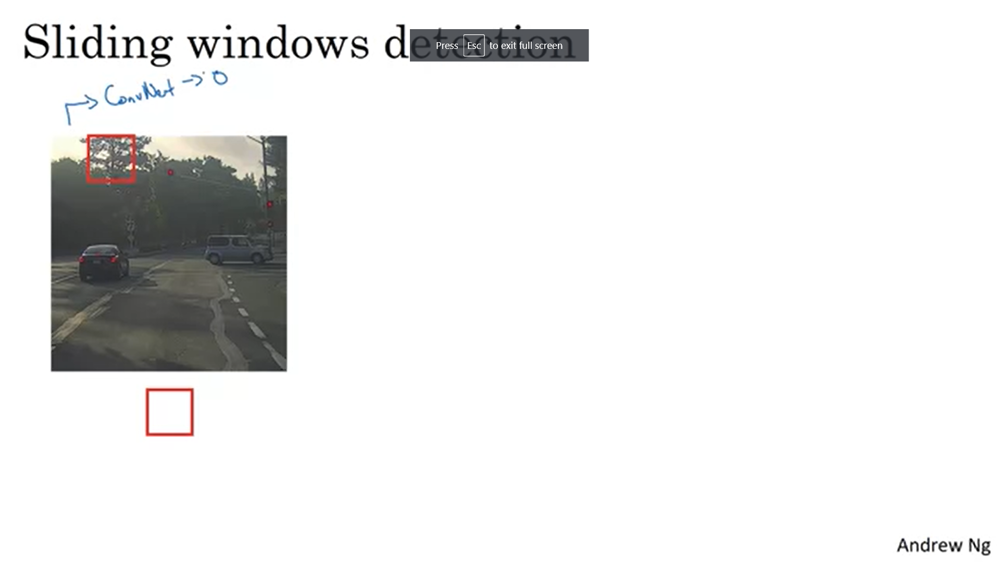

And I'm using a pretty large stride in this example just to make the animation go faster. But the idea is you basically go through every region of this size, and pass lots of little cropped images into the convNET and have it classified zero or one for each position as some stride. 

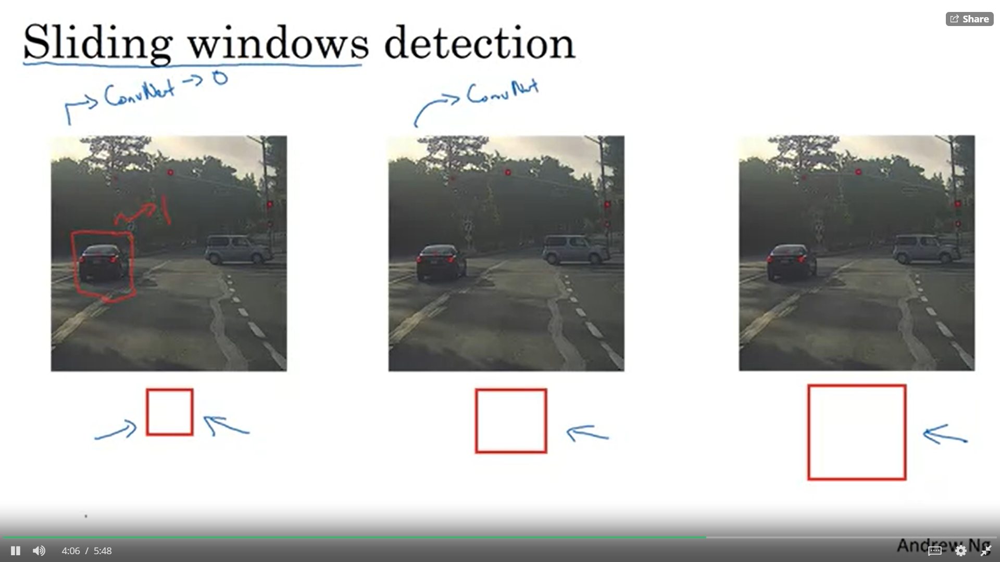

Now there's a huge disadvantage of Sliding Windows Detection, which is the computational cost. Because you're cropping out so many different square regions in the image and running each of them independently through a convNET. And if you use a very coarse stride, a very big stride, a very big step size, then that will reduce the number of windows you need to pass through the convNET, but that courser granularity may hurt performance. Whereas if you use a very fine granularity or a very small stride, then the huge number of all these little regions you're passing through the convNET means that means there is a very high computational cost.

So, before the rise of Neural Networks people used to use much simpler classifiers like a simple linear classifier over hand engineer features in order to perform object detection. And in that era because each classifier was relatively cheap to compute, it was just a linear function, Sliding Windows Detection ran okay. It was not a bad method, but with convNET now running a single classification task is much more expensive and sliding windows this way is infeasibily slow. And unless you use a very fine granularity or a very small stride, you end up not able to localize the objects that accurately within the image as well.

# Convolutional Implementation of Sliding Windows

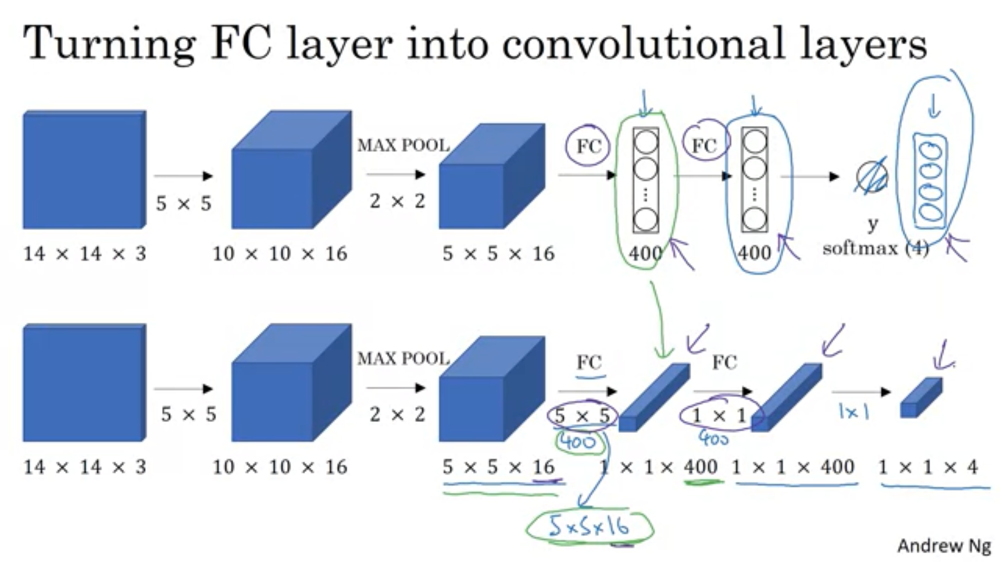

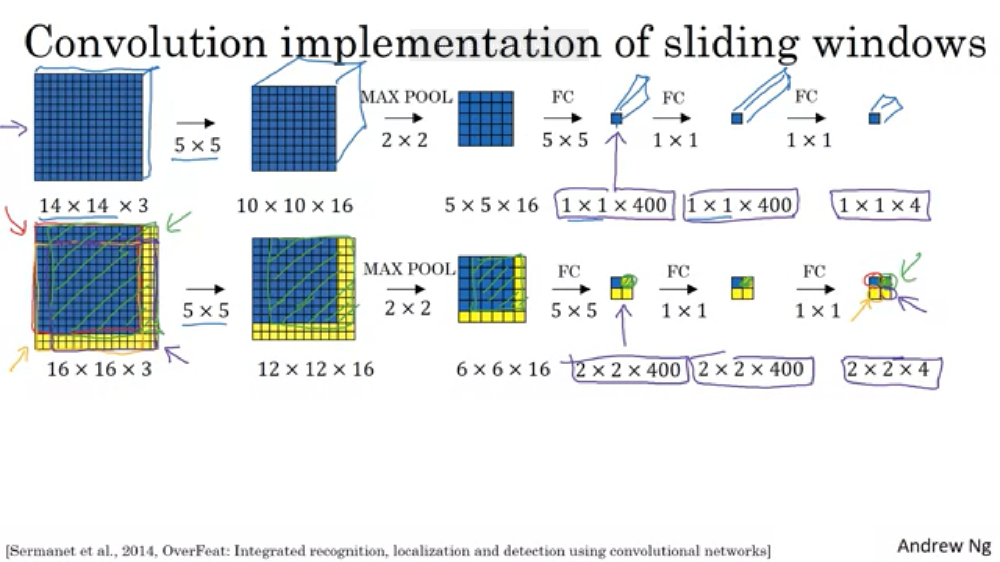

Instead of passing 4 sliding window into convNET to detect the object . We did a convolution implementaion of these four sliding window which do parallel computation (share a lot of pixel values) to find at the end a 2*2 matrix for all four sliding window.

To run sliding windows on this 16 by 16 by 3 image is pretty small image. You run this convnet four times in order to get four labels. But it turns out a lot of this computation done by these four convnets is highly duplicative. So what the convolutional implementation of sliding windows does is it allows these four pauses in the convnet to share a lot of computation

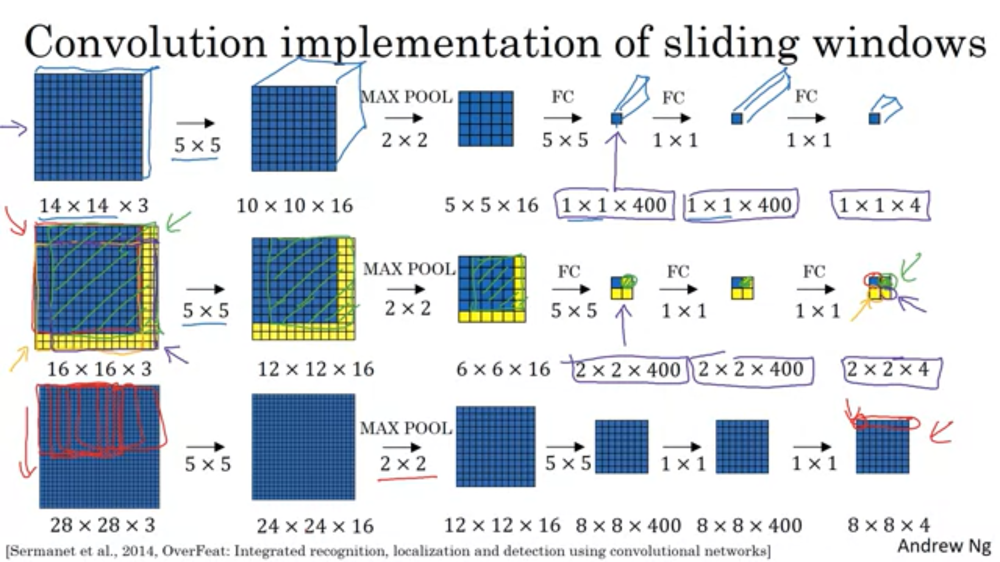

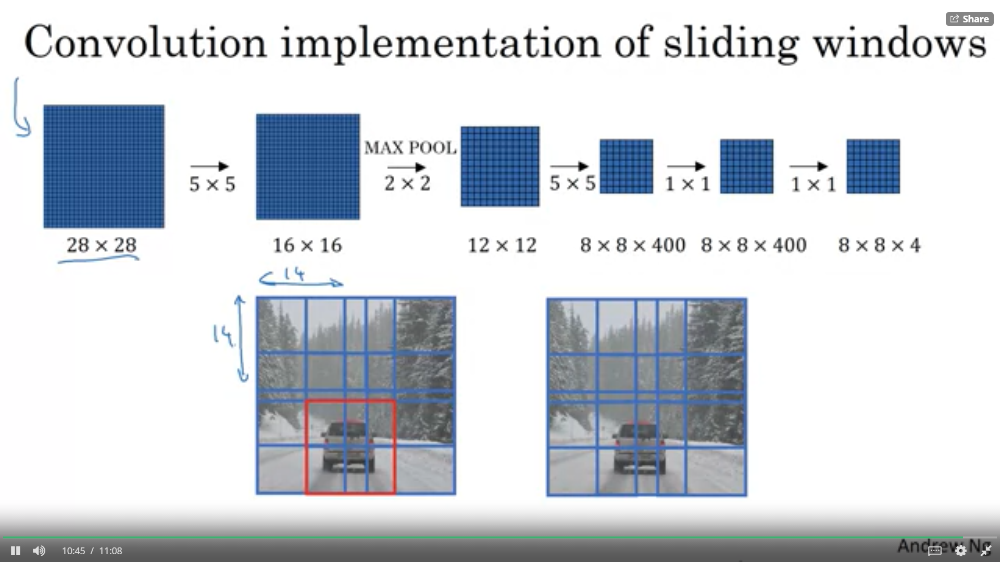

But now, instead of doing it sequentially, with this convolutional implementation that you saw in the previous slide, you can implement the entire image, all maybe 28 by 28 and convolutionally make all the predictions at the same time by one forward pass through this big convnet and hopefully have it recognize the position of the car. So that's how you implement sliding windows convolutionally and it makes the whole thing much more efficient. `Now, this algo. still has one weakness, which is the position of the bounding boxes is not going to be too accurate. In the next video, let's see how you can fix that problem.`

# Bounding Box Predictions


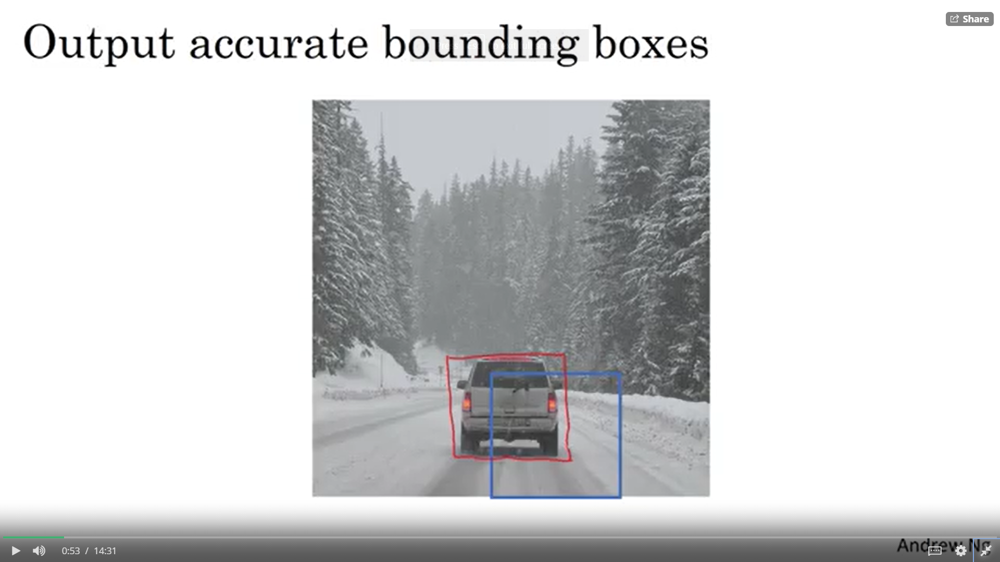

With sliding windows, you take this three sets of locations and run the crossfire through it. And in this case, none of the boxes really match up perfectly with the position of the car. So, maybe that box is the best match. And also, it looks like in drawn through, the perfect bounding box isn't even quite square, it's actually has a slightly wider rectangle or slightly horizontal aspect ratio. So, is there a way to get this algorithm to outputs more accurate bounding boxes? A good way to get this output more accurate bounding boxes is with the YOLO algorithm. `YOLO stands for, You Only Look Once.` 

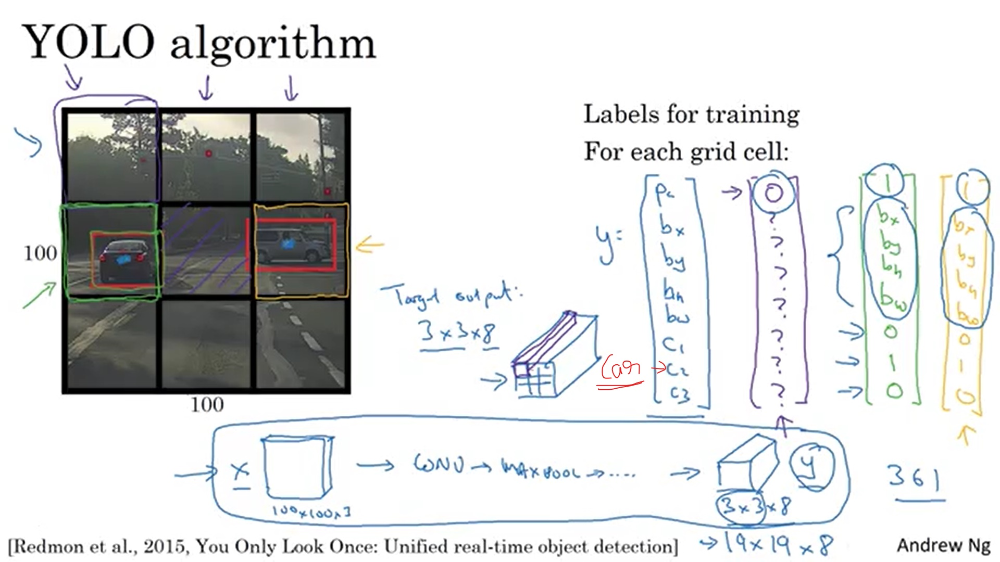

So notice two things, 
* first, this is a lot like the image classification and localization algorithm that we talked about in the first video of this week. And that it outputs the bounding balls coordinates explicitly. And so this allows in your network to output bounding boxes of any aspect ratio, as well as, output much more precise coordinates that aren't just dictated by the stripe size of your sliding windows classifier.
* And second, this is a convolutional implementation and you're not implementing this algorithm nine times on the 3 by 3 grid or if you're using a 19 by 19 grid.19 squared is 361. So, you're not running the same algorithm 361 times or 19 squared times. Instead, this is one single convolutional implantation, where you use one consonant with a lot of shared computation between all the computations needed for all of your 3 by 3 or all of your 19 by 19 grid cells. So, this is a pretty efficient algorithm. And in fact, one nice thing about the YOLO algorithm, which is constant popularity is because this is a convolutional implementation, it actually runs very fast

`Our system divides the input image into an S × S grid. If the center of an object falls into a grid cell, that grid cell is responsible for detecting that object.`

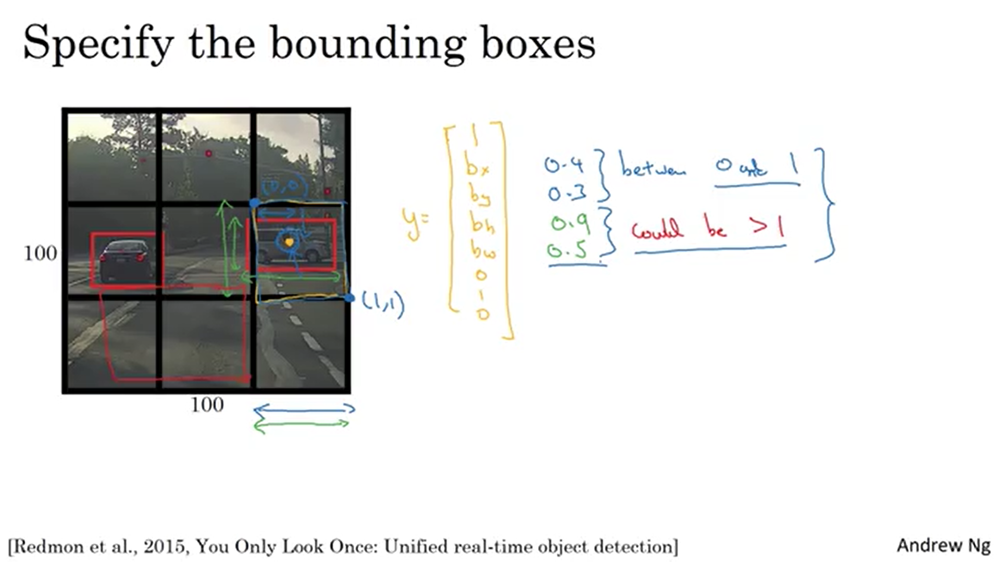

# Intersection Over Union

Function which evaluate your object localization Bounding Box is correct or Not.

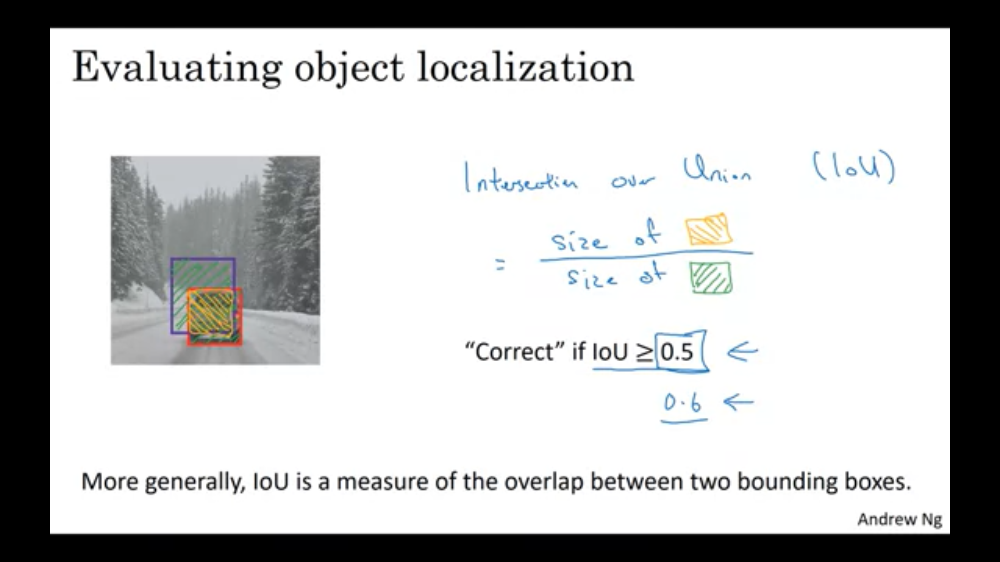

So what the intersection over union function does, or IoU does, is it computes the intersection over union of these two bounding boxes. So, the union of these two bounding boxes is this area, is really the area that is contained in either bounding boxes, whereas the intersection is this smaller region here. So what the intersection of a union does is it computes the size of the intersection. So that orange shaded area, and divided by the size of the union, which is that green shaded area. And by convention, the low compute division task will judge that your answer is correct if the IoU is greater than 0.5. And if the predicted and the ground-truth bounding boxes overlapped perfectly, the IoU would be one, because the intersection would equal to the union.

# Non-max Suppression

One of the problems of Object Detection as you've learned about this so far, is that your algorithm may find multiple detections of the same objects. Rather than detecting an object just once, it might detect it multiple times. Non-max suppression is a way for you to make sure that your algorithm detects each object only once. 

 Let's go through an example. Let's say you want to detect pedestrians, cars, and motorcycles in this image. You might place a grid over this, and this is a 19 by 19 grid. Now, while technically this car has just one midpoint, so it should be assigned just one grid cell. And the car on the left also has just one midpoint, so technically only one of those grid cells should predict that there is a car. In practice, you're running an object classification and localization algorithm for every one of these split cells. So it's quite possible that this split cell might think that the center of a car is in it, and so might this, and so might this, and for the car on the left as well.

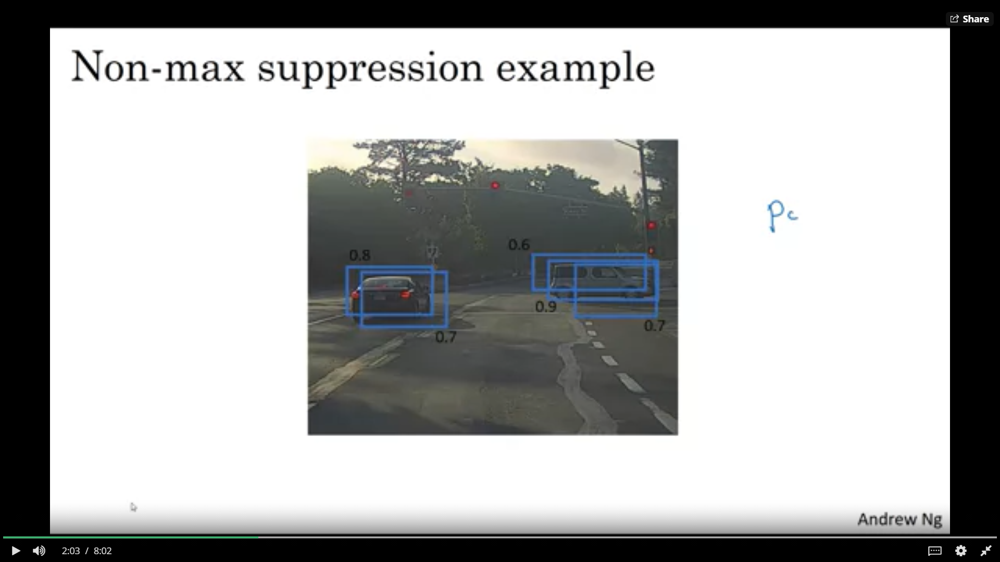

So, when you run your algorithm, you might end up with multiple detections of each object. So, what non-max suppression does, is it cleans up these detections. So they end up with just one detection per car, rather than multiple detections per car.
`So, this is non-max suppression. And non-max means that you're going to output your maximal probabilities classifications but suppress the close-by ones that are non-maximal. Hence the name, non-max suppression.`

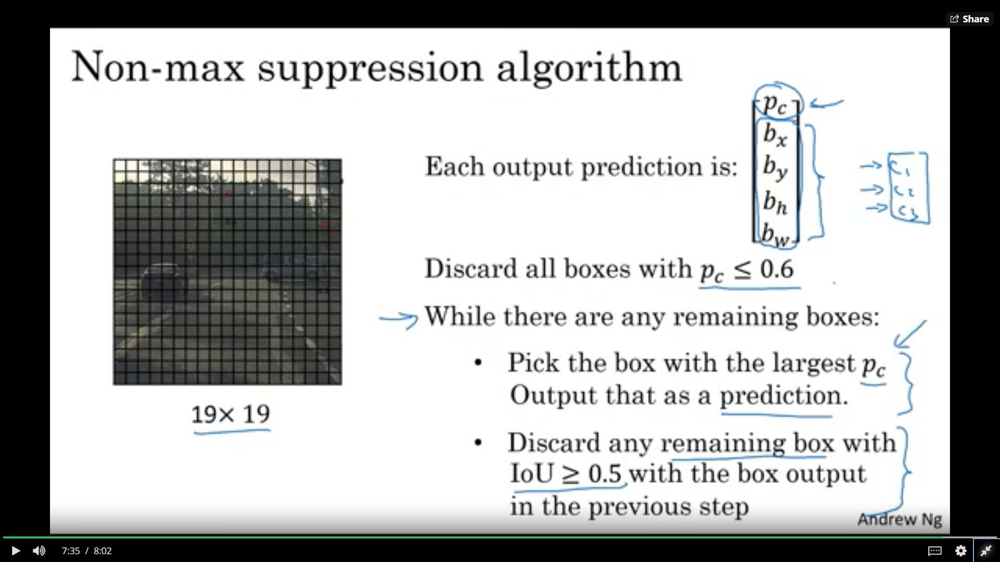

I've described the algorithm using just a single object on this slide. If you actually tried to detect three objects say pedestrians, cars, and motorcycles, then the output vector will have three additional components. And it turns out, the right thing to do is to independently carry out non-max suppression three times, one on each of the outputs classes. But the details of that, I'll leave to this week's program exercise where you get to implement that yourself, where you get to implement non-max suppression yourself on multiple object classes. 

# Anchor Boxes

One of the problems with object detection as you have seen it so far is that each of the grid cells can detect only one object. What if a grid cell wants to detect multiple objects? Here is what you can do. You can use the idea of anchor boxes.

With the idea of anchor boxes, what you are going to do, is pre-define two different shapes called, anchor boxes or anchor box shapes. And what you are going to do is now, be able to associate two predictions with the two anchor boxes. And in general, you might use more anchor boxes, maybe five or even more.

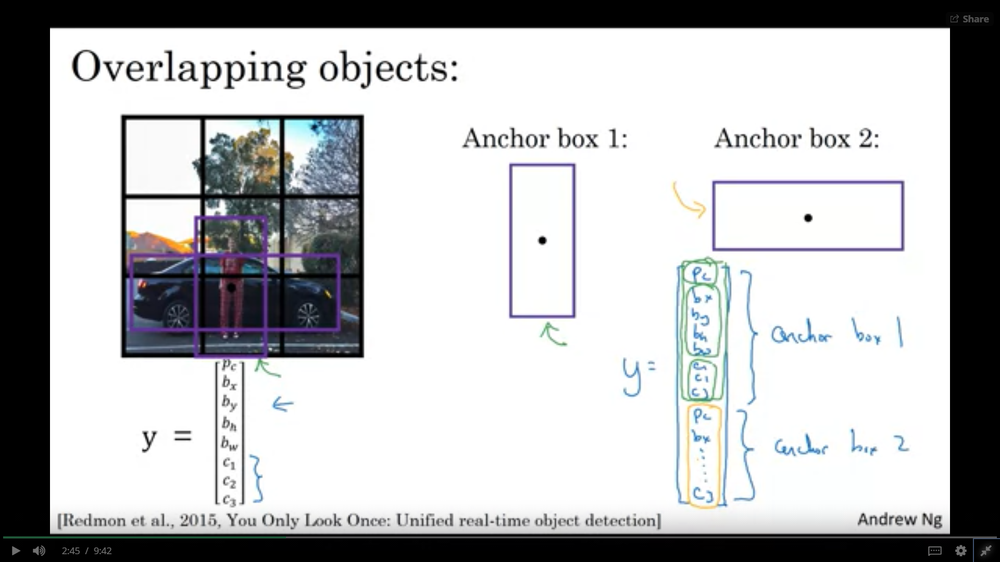

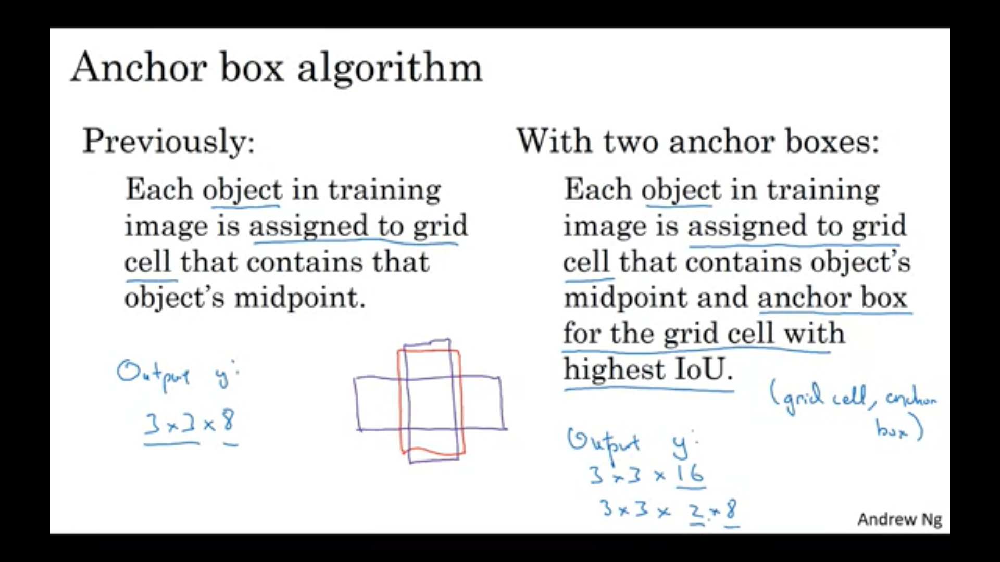

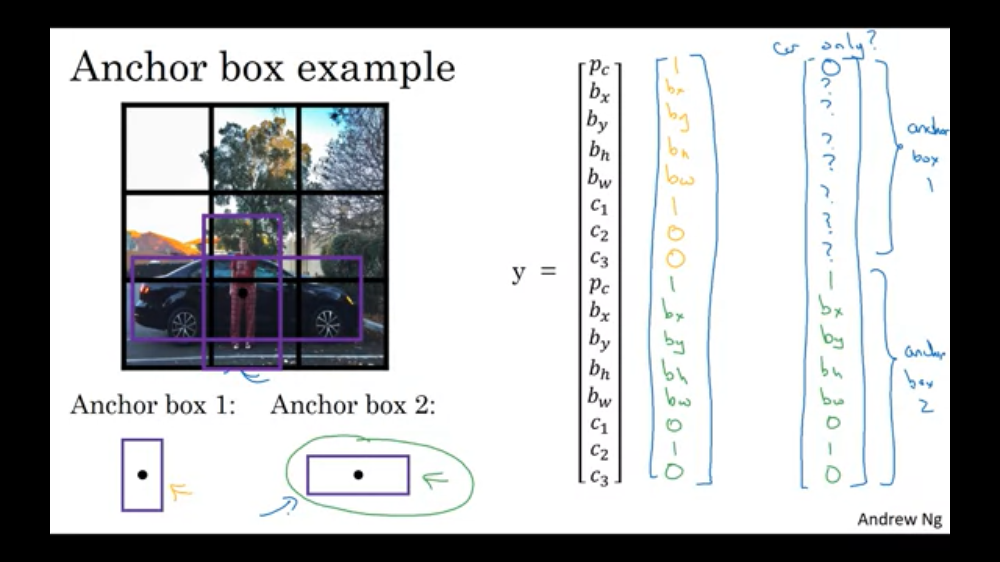

What if you have two anchor boxes but three objects in the same grid cell? That's one case that this algorithm doesn't handle well. Hopefully, it won't happen. But if it does, this algorithm doesn't have a great way of handling it. I will just influence some default tiebreaker for that case. Or what if you have two objects associated with the same grid cell, but both of them have the same anchor box shape? Again, that's another case that this algorithm doesn't handle well. If you influence some default way of tiebreaking if that happens, hopefully this won't happen with your data set, it won't happen much at all. And so, it shouldn't affect performance as much. So, that's it for anchor boxes

# Putting it Together:YOLO Algorithm

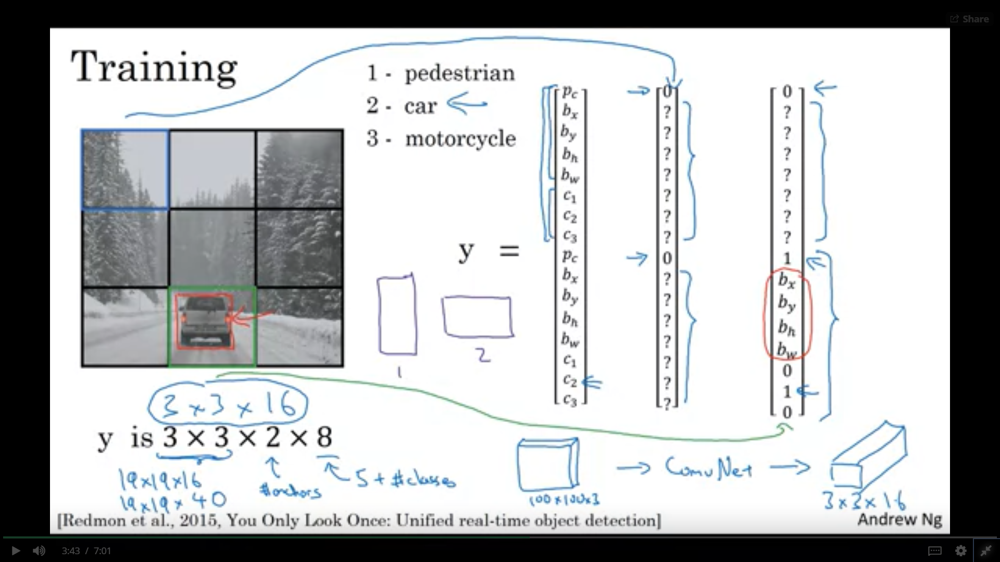

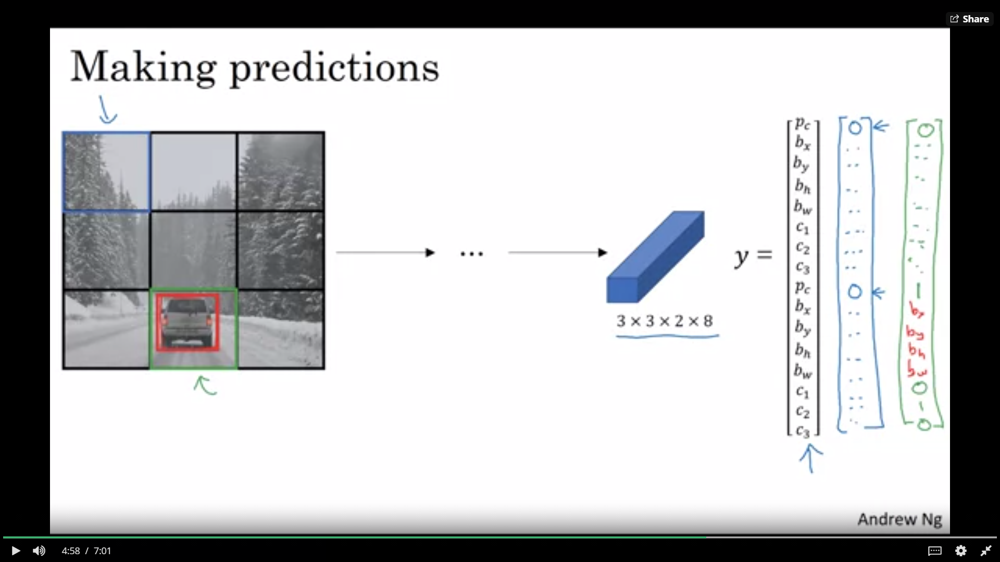

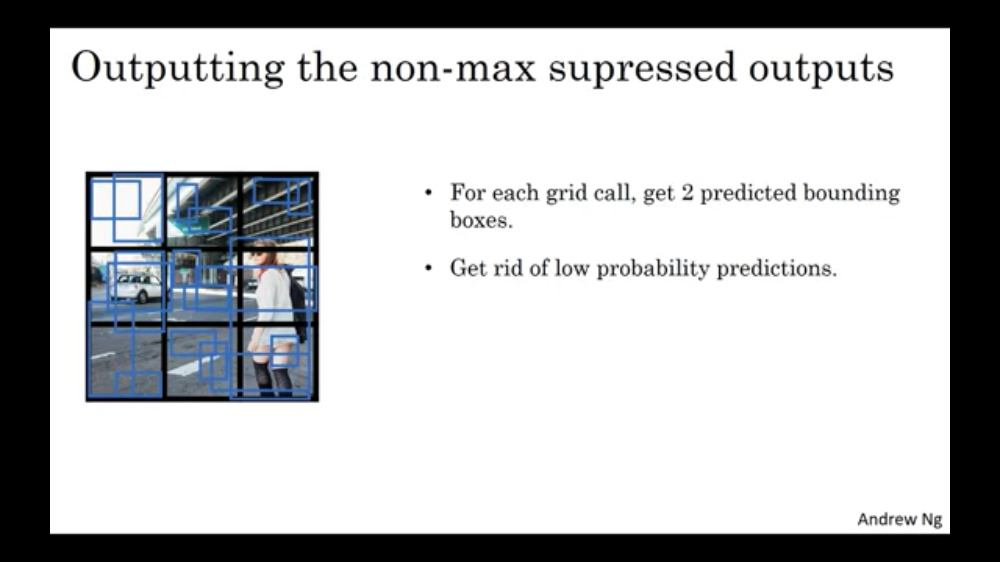

If you're using two anchor boxes, then for each of the non-grid cells, you get two predicted bounding boxes. Some of them will have very low probability, very low Pc, but you still get two predicted bounding boxes for each of the nine grid cells. So let's say, those are the bounding boxes you get. And notice that some of the bounding boxes can go outside the height and width of the grid cell that they came from. Next, you then get rid of the low probability predictions. So get rid of the ones that even the neural network says, gee this object probably isn't there. So get rid of those. And then finally if you have three classes you're trying to detect, you're trying to detect pedestrians, cars and motorcycles. What you do is, for each of the three classes, independently run non-max suppression for the objects that were predicted to come from that class. But use non-max suppression for the predictions of the pedestrians class, run non-max suppression for the car class, and non-max suppression for the motorcycle class. But run that basically three times to generate the final predictions. And so the output of this is hopefully that you will have detected all the cars and all the pedestrians in this image. So that's it for the YOLO object detection algorithm.

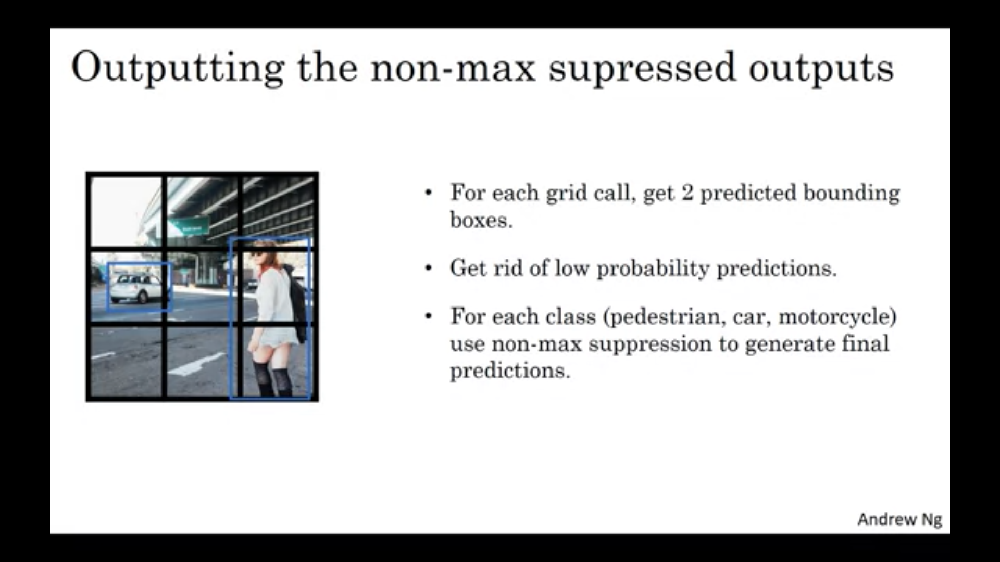

# Region Propasal:R-CNN

There is an algorithm called R-CNN, which stands for Regions with convolutional networks or regions with CNNs. And what that does is it tries to pick just a few regions that makes sense to run your continent crossfire. So rather than running your sliding windows on every single window, you instead select just a few windows and run your continent crossfire on just a few windows. The way that they perform the region proposals is to run an algorithm called a segmentation algorithm, that results in this output on the right, in order to figure out what could be objects.

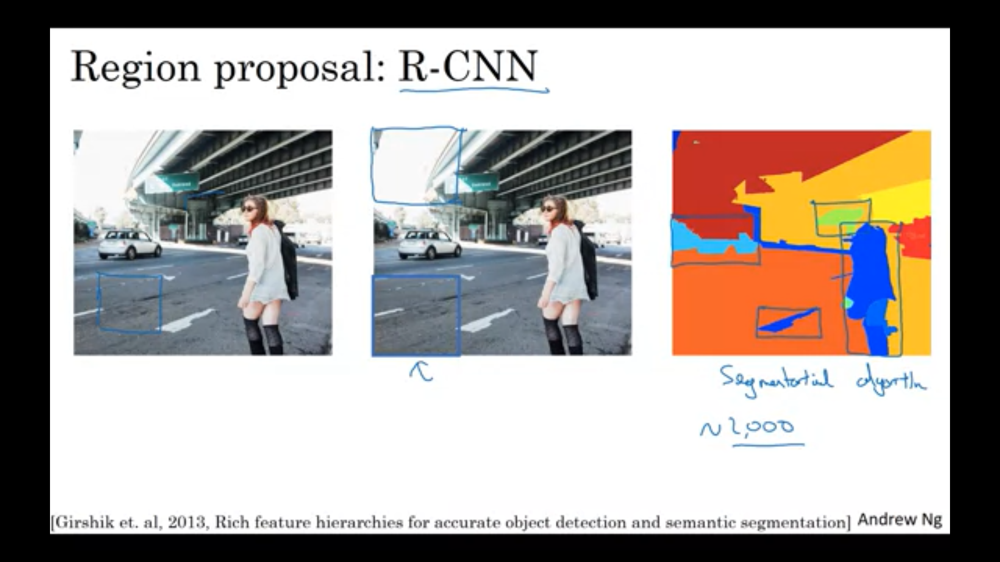

IN this algo. we run the classifier on different segmented region.

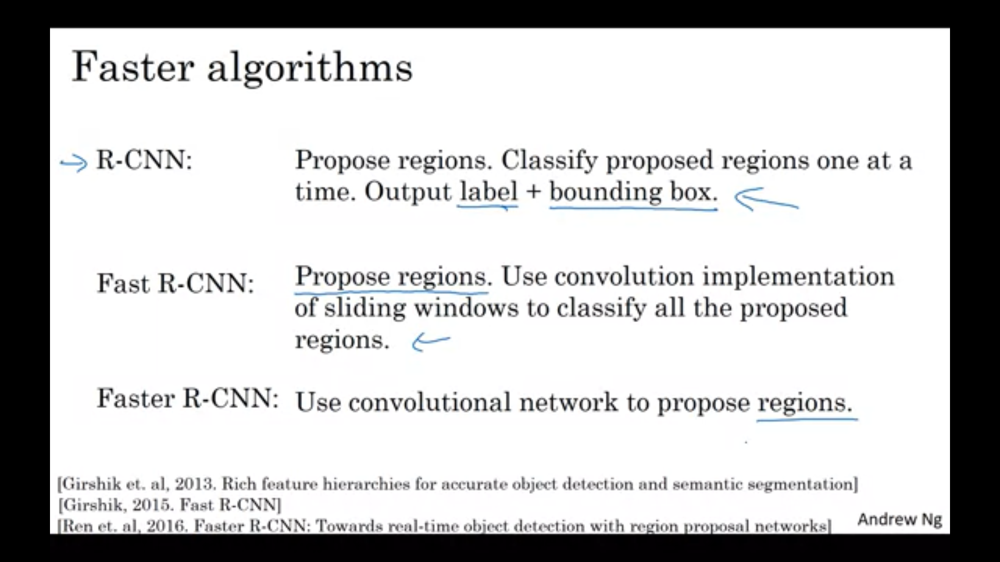

* Now, one downside of the R-CNN algorithm was that it is actually quite slow. So over the years, there been a few improvements to the R-CNN algorithm. 
* So the original implementation would actually classify the regions one at a time. So far, R-CNN use a convolutional implementation of sliding windows, and this is roughly similar to the idea you saw in the fourth video of this week. And that speeds up R-CNN quite a bit. It turns out that one of the problems of fast R-CNN algorithm is that the clustering step to propose the regions is still quite slow .
*  faster R-CNN algorithm, which uses a convolutional neural network instead of one of the more traditional segmentation algorithms to propose a blob on those regions, and that wound up running quite a bit faster than the fast R-CNN algorithm. Although, I think the faster R-CNN algorithm, most implementations are usually still quit a bit slower than the YOLO algorithm. So the idea of region proposals has been quite influential in computer vision, and I wanted you to know about these ideas because you see others still used these ideas, for myself, and this is my personal opinion, not the opinion of the computer vision research committee as a whole. 